In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
from IPython.display import Image


from scipy import stats
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor


## Data Cleaning 

In [2]:
#Importing data
ny_df = pd.read_csv('/Users/emilykasa/Desktop/repos/Capstone_Project/capstone_data/new-york-city-airbnb-open-data/AB_NYC_2019.csv')
ny_df.head()
#ny_df.info()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [3]:
ny_df[ny_df["name"].isna()]

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
2854,1615764,NaN,6676776,Peter,Manhattan,Battery Park City,40.71239,-74.01620,Entire home/apt,400,1000,0,NaN,NaN,1,362
3703,2232600,NaN,11395220,Anna,Manhattan,East Village,40.73215,-73.98821,Entire home/apt,200,1,28,2015-06-08,0.45,1,341
5775,4209595,NaN,20700823,Jesse,Manhattan,Greenwich Village,40.73473,-73.99244,Entire home/apt,225,1,1,2015-01-01,0.02,1,0
5975,4370230,NaN,22686810,Michaël,Manhattan,Nolita,40.72046,-73.99550,Entire home/apt,215,7,5,2016-01-02,0.09,1,0
6269,4581788,NaN,21600904,Lucie,Brooklyn,Williamsburg,40.71370,-73.94378,Private room,150,1,0,NaN,NaN,1,0
6567,4756856,NaN,1832442,Carolina,Brooklyn,Bushwick,40.70046,-73.92825,Private room,70,1,0,NaN,NaN,1,0
6605,4774658,NaN,24625694,Josh,Manhattan,Washington Heights,40.85198,-73.93108,Private room,40,1,0,NaN,NaN,1,0
8841,6782407,NaN,31147528,Huei-Yin,Brooklyn,Williamsburg,40.71354,-73.93882,Private room,45,1,0,NaN,NaN,1,0
11963,9325951,NaN,33377685,Jonathan,Manhattan,Hell's Kitchen,40.76436,-73.98573,Entire home/apt,190,4,1,2016-01-05,0.02,1,0
12824,9787590,NaN,50448556,Miguel,Manhattan,Harlem,40.80316,-73.95189,Entire home/apt,300,5,0,NaN,NaN,5,0


In [4]:
#Take a look at naan values
missing_data_summary = (ny_df.isnull().sum()/len(ny_df))*100
missing_data_summary
#looks like if there are no reviews then last review and reviews per month are both NaN

id                                 0.000000
name                               0.032723
host_id                            0.000000
host_name                          0.042949
neighbourhood_group                0.000000
neighbourhood                      0.000000
latitude                           0.000000
longitude                          0.000000
room_type                          0.000000
price                              0.000000
minimum_nights                     0.000000
number_of_reviews                  0.000000
last_review                       20.558339
reviews_per_month                 20.558339
calculated_host_listings_count     0.000000
availability_365                   0.000000
dtype: float64

In [5]:
#dropping rows with nan would mean losing 20% of our data, but dropping the columns would be a loss of a possibly important predictor
ny_df[ny_df.isna()["reviews_per_month"]]
reviews_per_month_no_nan=ny_df[ny_df.notnull()["reviews_per_month"]]
reviews_per_month_no_nan

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,2019-06-22,0.59,1,129
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48782,36425863,Lovely Privet Bedroom with Privet Restroom,83554966,Rusaa,Manhattan,Upper East Side,40.78099,-73.95366,Private room,129,1,1,2019-07-07,1.00,1,147
48790,36427429,No.2 with queen size bed,257683179,H Ai,Queens,Flushing,40.75104,-73.81459,Private room,45,1,1,2019-07-07,1.00,6,339
48799,36438336,Seas The Moment,211644523,Ben,Staten Island,Great Kills,40.54179,-74.14275,Private room,235,1,1,2019-07-07,1.00,1,87
48805,36442252,1B-1B apartment near by Metro,273841667,Blaine,Bronx,Mott Haven,40.80787,-73.92400,Entire home/apt,100,1,2,2019-07-07,2.00,1,40


In [6]:
#Lets replace the nan values in the reviews_per_month with 0 and drop the last_review  column
ny_df["reviews_per_month"] = ny_df["reviews_per_month"].fillna(0)
ny_df.drop('last_review', axis=1, inplace=True)

In [7]:
#Now lets deal with the missing names and host names. Since we might want to use names later, we wont drop
#We also want to get rid of NaN values, so we'll replace NaN with Unkown 

ny_df["name"] = ny_df["name"].fillna("Unknown")
ny_df["host_name"] = ny_df["name"].fillna("Unknown")


In [8]:
#making sure we don't have any nan values left 
missing_data_summary = (ny_df.isnull().sum()/len(ny_df))*100
missing_data_summary

id                                0.0
name                              0.0
host_id                           0.0
host_name                         0.0
neighbourhood_group               0.0
neighbourhood                     0.0
latitude                          0.0
longitude                         0.0
room_type                         0.0
price                             0.0
minimum_nights                    0.0
number_of_reviews                 0.0
reviews_per_month                 0.0
calculated_host_listings_count    0.0
availability_365                  0.0
dtype: float64

In [9]:
#Moving price to the end of the dataframe
ny_df.columns
ny_df=ny_df[['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type',
       'minimum_nights', 'number_of_reviews', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365','price']]

In [12]:
#Lets just take a look at our target, price, to see what kind of distribution it has
fig = px.histogram(ny_df, x="price", nbins=30, title='Histogram of Price (Whole Dataset)')
fig.show()
print(f'The mean price is {ny_df["price"].mean()}')
print(f'The median price is {ny_df["price"].median()}')
print(f'The max price is {ny_df["price"].max()}')

The mean price is 152.7206871868289
The median price is 106.0
The max price is 10000


In [15]:
#Lets just take a look at our target, price, to see what kind of distribution it has
fig = px.histogram(ny_df[ny_df["price"]<1000], x="price", nbins=30, title='Histogram of Price (Price Less Than 1000)')
Image(pio.to_image(fig, format='png'))

print(f'The mean price is {ny_df[ny_df["price"]<1000]["price"].mean()}')
print(f'The median price is {ny_df[ny_df["price"]<1000]["price"].median()}')
print(f'The max price is {ny_df[ny_df["price"]<1000]["price"].max()}')
print(f'Dropping {len(ny_df[ny_df["price"]>1000])} rows')
print(f'Dropping {len(ny_df[ny_df["price"]>1000])} rows, {round((len(ny_df[ny_df["price"]>1000]))/len(ny_df), 3)*100} percent')

The mean price is id                                1.902170e+07
host_id                           6.763529e+07
latitude                          4.072892e+01
longitude                        -7.395203e+01
minimum_nights                    6.975019e+00
number_of_reviews                 2.337527e+01
reviews_per_month                 1.095423e+00
calculated_host_listings_count    7.168014e+00
availability_365                  1.123679e+02
price                             1.402373e+02
dtype: float64
The median price is id                                1.967775e+07
host_id                           3.084879e+07
latitude                          4.072296e+01
longitude                        -7.395557e+01
minimum_nights                    3.000000e+00
number_of_reviews                 5.000000e+00
reviews_per_month                 3.800000e-01
calculated_host_listings_count    1.000000e+00
availability_365                  4.400000e+01
price                             1.050000e+02
dtype: 

In [17]:
#Lets just take a look at our target, price, to see what kind of distribution it has
fig = px.histogram(ny_df[ny_df["price"]<250], x="price", nbins=30, title='Histogram of Price (Price Less Than 250)')
Image(pio.to_image(fig, format='png'))

print(f'The mean price is {ny_df[ny_df["price"]<250]["price"].mean()}')
print(f'The median price is {ny_df[ny_df["price"]<250]["price"].median()}')
print(f'The max price is {ny_df[ny_df["price"]<250]["price"].max()}')
print(f'Dropping {len(ny_df[ny_df["price"]>250])} rows, {round((len(ny_df[ny_df["price"]>250]))/len(ny_df), 3)*100} percent')

The mean price is 107.89774777941831
The median price is 99.0
The max price is 249
Dropping 5208 rows, 10.7 percent


For this notebook, lets focus on prices that are below 250 dollars. Our data is a lot less skewed for lower prices, and prices above 250 dollars only make up 10% of the data. 

In [13]:
ny_df=ny_df[ny_df["price"]<250]

## EDA##

In [14]:
#Lets just check some basic correllation properties
ny_df.corr().style.background_gradient(cmap='coolwarm')

,id,host_id,latitude,longitude,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price
id,1.000000,0.578745,-0.012937,0.111144,-0.016958,-0.319251,0.179035,0.109280,0.064516,-0.058160
host_id,0.578745,1.000000,0.011402,0.153756,-0.018503,-0.135381,0.203946,0.147376,0.188989,-0.072220
latitude,-0.012937,0.011402,1.000000,0.099799,0.024985,-0.010328,-0.018818,0.018771,-0.022213,0.064524
longitude,0.111144,0.153756,0.099799,1.000000,-0.061208,0.050426,0.143190,-0.096136,0.104441,-0.306625
minimum_nights,-0.016958,-0.018503,0.024985,-0.061208,1.000000,-0.081626,-0.125549,0.115577,0.140952,0.029095
number_of_reviews,-0.319251,-0.135381,-0.010328,0.050426,-0.081626,1.000000,0.598274,-0.063541,0.188478,-0.004717
reviews_per_month,0.179035,0.203946,-0.018818,0.143190,-0.125549,0.598274,1.000000,-0.040638,0.172799,-0.044371
calculated_host_listings_count,0.109280,0.147376,0.018771,-0.096136,0.115577,-0.063541,-0.040638,1.000000,0.223179,0.163544
availability_365,0.064516,0.188989,-0.022213,0.104441,0.140952,0.188478,0.172799,0.223179,1.000000,0.043715
price,-0.058160,-0.072220,0.064524,-0.306625,0.029095,-0.004717,-0.044371,0.163544,0.043715,1.000000


### Name EDA

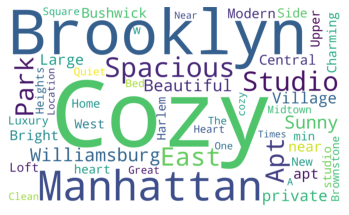

In [15]:
#Lets build a wordcloud of common names in 

from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator


text = " ".join(name for name in ny_df.name)

whitelist = set('abcdefghijklmnopqrstuvwxyz ABCDEFGHIJKLMNOPQRSTUVWXYZ')

names_concat = ''.join(filter(whitelist.__contains__, text))
names_concat=names_concat.split(" ")

word_counts={}
for i in names_concat:
    if i not in word_counts:
        word_counts[i]=0
    word_counts[i]+=1

#Get rid of words with little meaning
stopwords = set(STOPWORDS)
stopwords.update(["Room", "Bedroom", "Private", "In", "in", "NYC", "apartment", "room", "bedroom", "br", "Apartment", "BR", " "])

for i in stopwords:
    if i in word_counts:
        del word_counts[i]


wordcloud = WordCloud(background_color="white", width=5000, height=3000, max_words=50).generate_from_frequencies(word_counts)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

#text

One explanatory variable that would be helpful to our data would be number of bedrooms. Although we have a room type field, understanding the number of bedrooms might have more predictive power. Lets see if it's possible to strip out number of bedrooms from the name field.

In [16]:
#trying to see if we can get info on number of bedrooms from name
#\d+\s(?i)(

import re 
bedrooms=[]
for i in ny_df["name"]:
    m=re.match("^\d+\s(?i)(br|bedroom)", i)
    bedrooms.append(m)    

ny_df["number_of_bedrooms"]=bedrooms
ny_df["number_of_bedrooms"] = ny_df["number_of_bedrooms"].fillna("Unknown")
ny_df["number_of_bedrooms"] = ny_df["number_of_bedrooms"].astype('category')


ny_df.groupby("number_of_bedrooms")["price"].mean()




/opt/anaconda3/envs/deeplearning/lib/python3.6/site-packages/ipykernel_launcher.py:7: DeprecationWarning:

Flags not at the start of the expression '^\\d+\\s(?i)(br|bedroo' (truncated)



number_of_bedrooms
Unknown                                                    107.566487
<_sre.SRE_Match object; span=(0, 9), match='2 bedroom'>    105.000000
<_sre.SRE_Match object; span=(0, 9), match='1 Bedroom'>    130.000000
<_sre.SRE_Match object; span=(0, 9), match='1 Bedroom'>    195.000000
<_sre.SRE_Match object; span=(0, 9), match='1 Bedroom'>    230.000000
                                                              ...    
<_sre.SRE_Match object; span=(0, 9), match='2 Bedroom'>    195.000000
<_sre.SRE_Match object; span=(0, 9), match='3 Bedroom'>    110.000000
<_sre.SRE_Match object; span=(0, 4), match='3 Br'>         245.000000
<_sre.SRE_Match object; span=(0, 9), match='2 bedroom'>     80.000000
<_sre.SRE_Match object; span=(0, 9), match='1 bedroom'>     80.000000
Name: price, Length: 639, dtype: float64

Looks like only 648 out of 40k have bedroom info. This is likely insufficient to do modelling with

Lets check out the word counts for the top most popular words in the name column. 

In [17]:
#sorting words_count dict by values (word counts)
import collections as c

sorted_keys = sorted(word_counts, key=word_counts.get, reverse=True)
sorted_keys

sorted_list_wc=[]
for r in sorted_keys:
    sorted_list_wc.append((r, word_counts[r]))

sorted_list_wc[1:20]

[('Cozy', 3951),
 ('Brooklyn', 3577),
 ('Manhattan', 2765),
 ('Spacious', 2707),
 ('Studio', 2617),
 ('East', 2353),
 ('Apt', 2336),
 ('Park', 2284),
 ('Williamsburg', 2223),
 ('Sunny', 2210),
 ('Beautiful', 1818),
 ('private', 1642),
 ('Village', 1597),
 ('Large', 1460),
 ('apt', 1351),
 ('near', 1348),
 ('Central', 1251),
 ('Bushwick', 1240),
 ('Bright', 1239)]

### Room Type EDA

In [18]:
#Lets look at prices based on room type

fig = px.histogram(ny_df, x="price", color="room_type", nbins=30, title='Histogram of Price By Room Type')
fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.75)
Image(pio.to_image(fig, format='png'))



### Minimum_nights EDA

In [19]:
fig = px.histogram(ny_df[ny_df["minimum_nights"]<10], x="minimum_nights", nbins=20, title='Histogram of Min Nights, 0-10 Min Nights')
Image(pio.to_image(fig, format='png'))


fig = px.histogram(ny_df[ny_df["minimum_nights"]<30], x="minimum_nights", nbins=20, title='Histogram of Min Nights, 0-30 Min Nights')
Image(pio.to_image(fig, format='png'))


fig = px.histogram(ny_df, x="minimum_nights", nbins=20, title='Histogram of Min Nights, Entire Data')
Image(pio.to_image(fig, format='png'))


print('the mode is ', ny_df["minimum_nights"].mode())
print('the median is ', ny_df["minimum_nights"].median())
print('the mean is ', ny_df["minimum_nights"].mean())




the mode is  0    1
dtype: int64
the median is  2.0
the mean is  6.856359417844336


min_nights_cat
long        628
medium    13556
short     28485
Name: id, dtype: int64

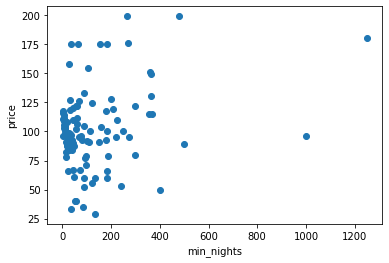

In [20]:
#Splitting minimum nights into short, medium, and long stay 
def min_nights_consolidate(min_nights):
    if min_nights <= 3:
        return "short"
    elif min_nights > 3 and min_nights <= 30:
        return "medium"
    else:
        return "long"
        
        
min_nights_consolidate(10)      
ny_df["min_nights_cat"]=ny_df["minimum_nights"].apply(min_nights_consolidate)
ny_df.groupby("minimum_nights")["price"].mean()

min_nights_mean=ny_df.groupby("minimum_nights")["price"].mean()
plt.scatter(x=min_nights_mean.index, y=min_nights_mean.values)
plt.xlabel("min_nights")
plt.ylabel("price")
ny_df.groupby("min_nights_cat")["id"].count()

In [21]:
#Lets look at prices based on room type

fig = px.histogram(ny_df, x="price", color="min_nights_cat", nbins=30, title='Histogram of Price By Room Type')
fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.75)
Image(pio.to_image(fig, format='png'))

### Longitude/Latitude EDA 

In [22]:
#Lets look at prices based on latitude (note that Mahattan has greater Longitude values than Brooklyn/Williamsburg)

fig = px.scatter(ny_df, x="longitude", y="price", title='Longitude vs Price', trendline='ols')
results = px.get_trendline_results(fig)
results = px.get_trendline_results(fig)
Image(pio.to_image(fig, format='png'))

In [23]:
#Lets look at prices based on latitude (note that Mahattan has higher latitude values)

fig = px.scatter(ny_df[ny_df["price"]<1000], x="latitude", y="price", title='Latitude vs Price', trendline='ols')
results = px.get_trendline_results(fig)
results = px.get_trendline_results(fig)
Image(pio.to_image(fig, format='png'))

It seems as though longitude has an inverse relationship with price and latitude has a postive relationship with price. This makes some sense as Manhattan has lower longitudinal coordinates and higher latitude coordinates. Longitude seems to be more predictive than latitude

### Neighborhood and Room_type EDA

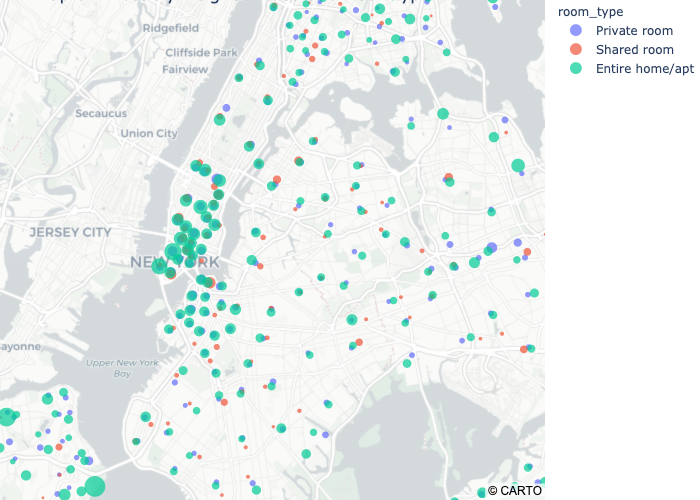

In [13]:
#Map looking at most expensive neighborhoods
from plotly.subplots import make_subplots

neighborhoods=ny_df.groupby(["neighbourhood", "room_type"])[["price", "latitude", "longitude", "minimum_nights"]].mean().reset_index()
neighborhoods.sort_values('price', ascending=False, inplace=True)
rich_neighborhoods=neighborhoods


fig = px.scatter_mapbox(rich_neighborhoods, lat="latitude", lon="longitude",  size="price", color="room_type", size_max=15, zoom=10, hover_name="neighbourhood", hover_data=["price", "minimum_nights"], title="Map of Prices By Neighborhood and Roomtype")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
Image(pio.to_image(fig, format='png'))
#we notice that the locations with the highest average per night cost also have the highest minimum night requirements


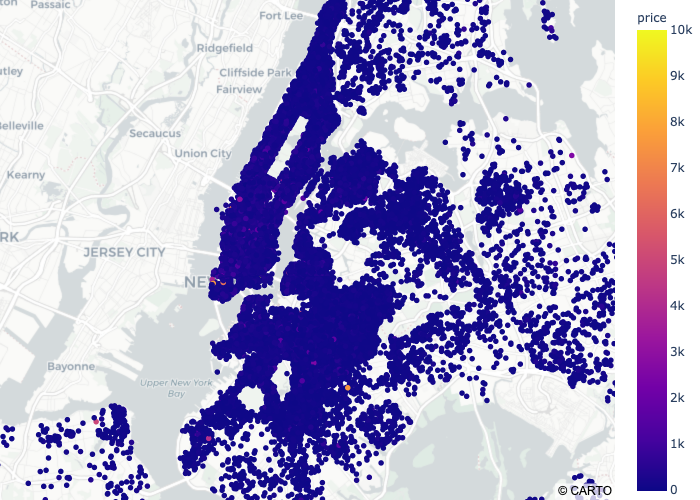

In [14]:
#Maps looking at prices for each Airbnb 


fig = px.scatter_mapbox(ny_df, lat="latitude", lon="longitude",  color="price", size_max=15, zoom=10)
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
Image(pio.to_image(fig, format='png'))

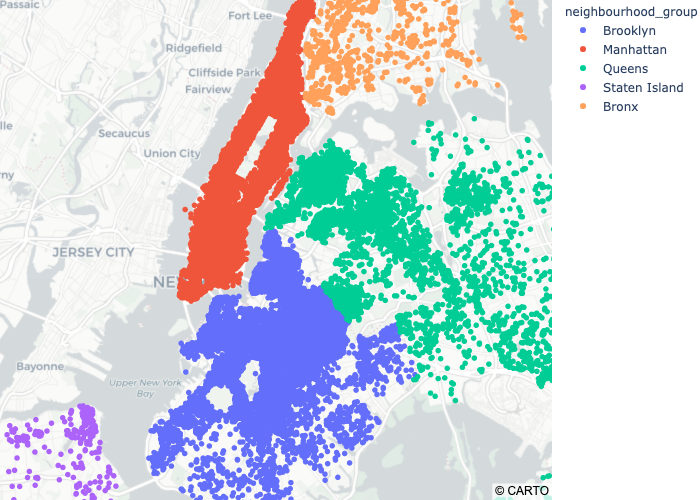

In [18]:
#Neighborhood Group Map
fig = px.scatter_mapbox(ny_df, lat="latitude", lon="longitude",  color="neighbourhood_group", size_max=15, zoom=10)
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
Image(pio.to_image(fig, format='png'))

## Modeling 

In [27]:
ny_df_columns=list(ny_df.columns)
ny_df_columns=['id',
 'name',
 'host_id',
 'host_name',
 'neighbourhood_group',
 'neighbourhood',
 'room_type',
 'minimum_nights',
 'number_of_reviews',
 'reviews_per_month',
 'calculated_host_listings_count',
 'availability_365','price']
ny_df.drop(["min_nights_cat","number_of_bedrooms"], inplace=True, axis=1)
ny_df=ny_df[ny_df["price"]<250]
ny_df.loc[:, ny_df.columns != 'price']
ny_df=ny_df.reset_index()

In [28]:
ny_df.drop("index", inplace=True, axis=1)

In [29]:
ny_df["price"].median()
ny_df["price"].mean()

107.89774777941831

### A Little More Preprocessing and Added Features

In [30]:
#adding dummies for roomtype
room_type_dummies=pd.get_dummies(ny_df['room_type'], prefix='room_type', drop_first=True).reset_index()
room_type_dummies.drop("index", axis=1, inplace=True)
ny_df_added_features = pd.concat([room_type_dummies, ny_df], axis=1)

#adding dist_from_midtown feature
ny_df_added_features["dist_from_midtown"]=abs(ny_df_added_features["latitude"]-40.7069)+abs(ny_df_added_features["latitude"]+74.0031)

#adding dummies for neighborhood group
ny_df_added_features = pd.concat([ny_df_added_features ,pd.get_dummies(ny_df_added_features['neighbourhood_group'], prefix='neighbourhood_group', drop_first=True)],axis=1)

#adding dummies for neighborhood
ny_df_added_features = pd.concat([ny_df_added_features ,pd.get_dummies(ny_df_added_features['neighbourhood'], prefix='neighbourhood', drop_first=True)],axis=1)



In [31]:
ny_df_added_features.drop(["neighbourhood_group", "neighbourhood", "room_type", "host_id", "host_name", "id"], axis=1, inplace=True)

In [32]:
ny_df_added_features.head()

,room_type_Private room,room_type_Shared room,name,latitude,longitude,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,...,neighbourhood_Westchester Square,neighbourhood_Westerleigh,neighbourhood_Whitestone,neighbourhood_Williamsbridge,neighbourhood_Williamsburg,neighbourhood_Willowbrook,neighbourhood_Windsor Terrace,neighbourhood_Woodhaven,neighbourhood_Woodlawn,neighbourhood_Woodside
0,1,0,Clean & quiet apt home by the park,40.64749,-73.97237,1,9,0.21,6,365,...,0,0,0,0,0,0,0,0,0,0
1,0,0,Skylit Midtown Castle,40.75362,-73.98377,1,45,0.38,2,355,...,0,0,0,0,0,0,0,0,0,0
2,1,0,THE VILLAGE OF HARLEM....NEW YORK !,40.80902,-73.94190,3,0,0.00,1,365,...,0,0,0,0,0,0,0,0,0,0
3,0,0,Cozy Entire Floor of Brownstone,40.68514,-73.95976,1,270,4.64,1,194,...,0,0,0,0,0,0,0,0,0,0
4,0,0,Entire Apt: Spacious Studio/Loft by central park,40.79851,-73.94399,10,9,0.10,1,0,...,0,0,0,0,0,0,0,0,0,0


In [33]:
#Splitting data into remainder (train and validation) and test split of 20% (calling X datarame "no words" because I haven't count vectorized the name column yet).
from sklearn.model_selection import train_test_split

X=ny_df_added_features.loc[:, ny_df_added_features.columns != 'price']
y=ny_df_added_features["price"]
split = 0.2
X_remainder_no_words, X_test_no_words, y_remainder, y_test = train_test_split(X, y, test_size=split, random_state=6)
for i in [X_remainder_no_words, X_test_no_words, y_remainder, y_test]:
    print(i.shape)



(34135, 233)
(8534, 233)
(34135,)
(8534,)


In [34]:
#Resettig axis and dropping index columns
X_remainder_no_words=X_remainder_no_words.reset_index()
X_remainder_no_words.drop("index", axis=1, inplace=True)

y_remainder=y_remainder.reset_index()
y_remainder.drop("index", axis=1, inplace=True)


X_test_no_words=X_test_no_words.reset_index()
X_test_no_words.drop("index", axis=1, inplace=True)

y_test=y_test.reset_index()
y_test.drop("index", axis=1, inplace=True)

In [35]:
#Scaling X data so we can compare the effect different coefficients are having
from sklearn.preprocessing import StandardScaler

X_remainder_no_words_scaled=X_remainder_no_words.copy()
X_test_no_words_scaled=X_test_no_words.copy()


scalerx = StandardScaler()
scalerx.fit(X_remainder_no_words_scaled[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']])
X_remainder_no_words_scaled[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']] = scalerx.transform(X_remainder_no_words_scaled[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']])
X_test_no_words_scaled[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']] = scalerx.transform(X_test_no_words_scaled[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']])




In [36]:
#Baseline linear regression using scaled data so we can evaluate coefficients (not including latitude/longitude/dist_from_midtown)
X = X_remainder_no_words_scaled[[ "room_type_Private room",
"room_type_Shared room",
"neighbourhood_group_Manhattan",
"neighbourhood_group_Brooklyn",
"neighbourhood_group_Queens",
"neighbourhood_group_Staten Island"]]
y = y_remainder
X_withconstant = sm.add_constant(X)

# 1. Instantiate Model
myregression = sm.OLS(y,X_withconstant)

# 2. Fit Model (this returns a seperate object with the parameters)
myregression_results = myregression.fit()

# Looking at the summary
myregression_results.summary()

#neighbourhood_group_Brooklyn", 

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.477
Model:                            OLS   Adj. R-squared:                  0.477
Method:                 Least Squares   F-statistic:                     5184.
Date:                Sun, 14 Jun 2020   Prob (F-statistic):               0.00
Time:                        14:19:56   Log-Likelihood:            -1.7331e+05
No. Observations:               34135   AIC:                         3.466e+05
Df Residuals:                   34128   BIC:                         3.467e+05
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
=====================================================================================================
                                        coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
const                               117.6071      1.371     85.789      0.000     114.920     120.294
room_type_Private room              -64.1328      0.430   -149.152      0.000     -64.976     -63.290
room_type_Shared room               -84.8349      1.311    -64.686      0.000     -87.405     -82.264
neighbourhood_group_Manhattan        41.2055      1.385     29.752      0.000      38.491      43.920
neighbourhood_group_Brooklyn         16.7387      1.381     12.121      0.000      14.032      19.445
neighbourhood_group_Queens            8.4073      1.466      5.734      0.000       5.534      11.281
neighbourhood_group_Staten Island     1.6081      2.702      0.595      0.552      -3.687       6.903
==============================================================================
Omnibus:                     2360.194   Durbin-Watson:                   2.005
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             3064.079
Skew:                           0.633   Prob(JB):                         0.00
Kurtosis:                       3.743   Cond. No.                         20.4
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [37]:
#Saving X_remainder and X_test versions with only the continuous variables to use later 
X_remainder_continuous = X_remainder_no_words[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365', 'dist_from_midtown']]
X_test_continuous=X_test_no_words[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365','dist_from_midtown']]



#adding expensive words in name to try to get more predictive power
expensive=["penthouse", "luxury", "renovated", "Penthouse", "Large", "Views", "Doorman", "Spacious", "park", "Park", "Tribecca"]

Expensive_words=[]
for name in X_train["name"]:
    expensive_word_count=0
    for i in expensive:
        if i in name:
            expensive_word_count+=1
    Expensive_words.append(expensive_word_count)
    


ny_df_added_features_train["Expensive_words"]=Expensive_words
ny_df_added_features_train.columns

In [38]:
print(X_remainder_no_words.shape)
print(X_test_no_words.shape)
print(y_remainder.shape)
print(y_test.shape)

(34135, 233)
(8534, 233)
(34135, 1)
(8534, 1)


In [39]:
def get_errors(X, y_test, model):
    y_pred=model.predict(X)
    y_test_df=y_test.copy()
    y_test_df["pred"]=y_pred
    y_test_df["error"]=(y_test_df["price"]-y_test_df["pred"])**(2)
    y_test_df["abs_error"]=abs((y_test_df["price"]-y_test_df["pred"]))



    print(f'RMSE={(((y_test_df["error"].sum()))/len(y_test_df))**(1/2)}')

    fig=px.histogram(x=y_test_df['abs_error'], nbins=30)


    fig.show()

In [40]:
#Try linear model using continuous data plust one hot encoded data for room_type and neighborhood_group

from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error


X_remainder_baseline=X_remainder_no_words[['room_type_Private room', 'room_type_Shared room', 'latitude', 'latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'calculated_host_listings_count', 'availability_365', 'dist_from_midtown', 'neighbourhood_group_Brooklyn', 'neighbourhood_group_Manhattan', 'neighbourhood_group_Queens', 'neighbourhood_group_Staten Island']]
X_test_baseline=X_test_no_words[['room_type_Private room', 'room_type_Shared room', 'latitude', 'latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'calculated_host_listings_count', 'availability_365', 'dist_from_midtown', 'neighbourhood_group_Brooklyn', 'neighbourhood_group_Manhattan', 'neighbourhood_group_Queens', 'neighbourhood_group_Staten Island']]


# 1. Instantiate the model
linear_regression_model = LinearRegression()

# 2. Fit the model
linear_regression_model.fit(X_remainder_baseline, y_remainder)

#The intercept
intercept = linear_regression_model.intercept_

#The coefficient, notice it returns an array with one spot for each feature
coefficient = linear_regression_model.coef_


model_prediction_train = linear_regression_model.predict(X_remainder_baseline)
model_prediction_test = linear_regression_model.predict(X_test_baseline)



# Evaluate the model on each set
print(f'The R2 score on the training set: {r2_score(y_remainder,model_prediction_train)}')
print(f'The R2 score on the testing set: {r2_score(y_test,model_prediction_test)}')

print(f'The RMSE score on the training set: {(mean_squared_error(y_remainder,model_prediction_train))**(1/2)}')
print(f'The RMSE score on the testing set: {(mean_squared_error(y_test,model_prediction_test))**(1/2)}')


#looks like we are massively overfitting- negative R2 on test 

The R2 score on the training set: 0.5292996337524933
The R2 score on the testing set: 0.5378989363586834
The RMSE score on the training set: 36.79317844494327
The RMSE score on the testing set: 37.0411823352542


In [41]:
X_remainder_added=X_remainder_no_words.loc[:, X_remainder_no_words.columns != 'name']
X_test_added=X_test_no_words.loc[:, X_test_no_words.columns != 'name']

# 1. Instantiate the model
linear_regression_model = LinearRegression()

# 2. Fit the model
linear_regression_model.fit(X_remainder_added, y_remainder)

#The intercept
intercept = linear_regression_model.intercept_

#The coefficient, notice it returns an array with one spot for each feature
coefficient = linear_regression_model.coef_


model_prediction_train = linear_regression_model.predict(X_remainder_added)
model_prediction_test = linear_regression_model.predict(X_test_added)



# Evaluate the model on each set
print(f'The R2 score on the training set: {r2_score(y_remainder,model_prediction_train)}')
print(f'The R2 score on the testing set: {r2_score(y_test,model_prediction_test)}')

print(f'The RMSE score on the training set: {(mean_squared_error(y_remainder,model_prediction_train))**(1/2)}')
print(f'The RMSE score on the testing set: {(mean_squared_error(y_test,model_prediction_test))**(1/2)}')


#looks like we are massively overfitting- negative R2 on test 

The R2 score on the training set: 0.5616502005605237
The R2 score on the testing set: 0.5634151667830181
The RMSE score on the training set: 35.5063021702777
The RMSE score on the testing set: 36.00399384750273


In [42]:
print(X_remainder_added.shape)
print(X_test_added.shape)
print(y_remainder.shape)
print(y_test.shape)





(34135, 232)
(8534, 232)
(34135, 1)
(8534, 1)


In [43]:
get_errors(X_test_added, y_test, linear_regression_model)

RMSE=36.00399384750273


In [44]:
#Now looking at the count vectorized name data 

from sklearn.feature_extraction.text import CountVectorizer




# 1. Instantiate 
bagofwords = CountVectorizer(min_df=10)

# 2. Fit 
bagofwords.fit(X_remainder_no_words["name"])

# 3. Transform
X_remainder_bagofwords = bagofwords.transform(X_remainder_no_words["name"])
X_test_bagofwords = bagofwords.transform(X_test_no_words["name"])




In [45]:
bagofwords.get_feature_names()
X_remainder_bagofwords.toarray()
X_test_bagofwords.toarray()


bag_of_words_train = pd.DataFrame(columns=bagofwords.get_feature_names(), data=X_remainder_bagofwords.toarray())
bag_of_words_test = pd.DataFrame(columns=bagofwords.get_feature_names(), data=X_test_bagofwords.toarray())




In [46]:
#Now we concat the count vectorized words to our X dataframes to get X_added_features
X_remainder_added_features=pd.concat([bag_of_words_train, X_remainder_no_words], axis=1)
X_test_added_features=pd.concat([bag_of_words_test, X_test_no_words], axis=1)

print(X_remainder_added_features.shape)
print(X_test_added_features.shape)



(34135, 1228)
(8534, 1228)


In [47]:
X_remainder_added_features.drop(["name"], axis=1, inplace=True)
X_test_added_features.drop(["name"], axis=1, inplace=True)

In [48]:
print(X_remainder_added_features.shape)
print(X_test_added_features.shape)

(34135, 1227)
(8534, 1227)


In [62]:
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge

# Create the lasso and ridge models
lasso = Lasso()
lasso.fit(X_remainder_added_features,y_remainder)
ridge = Ridge(alpha=20)
ridge.fit(X_remainder_added_features,y_remainder)

print("Coefficients:")
print("Lasso:", lasso.coef_)
print("Ridge:", ridge.coef_)
print("")


# Compare R-squared
print("R-squared:")
print("Lasso train:", lasso.score(X_remainder_added_features,y_remainder))
print("Ridge train:", ridge.score(X_remainder_added_features,y_remainder))
print("Lasso test:", lasso.score(X_test_added_features,y_test))
print("Ridge test:", ridge.score(X_test_added_features,y_test))


print(f'The RMSE score on the training set: {(mean_squared_error(y_remainder,model_prediction_train))**(1/2)}')
print(f'The RMSE score on the testing set: {(mean_squared_error(y_test,model_prediction_test))**(1/2)}')

print("Ridge Train and Test RMSE:")

print("Ridge Train")
get_errors(X_remainder_added_features, y_remainder, ridge)

print("Ridge Test")
get_errors(X_test_added_features, y_test, ridge)


print("Lasso Train")
get_errors(X_remainder_added_features, y_remainder, lasso)

print("Lasso Test")
get_errors(X_test_added_features, y_test, lasso)

Coefficients:
Lasso: [-0. -0. -0. ... -0. -0. -0.]
Ridge: [[ -4.33172228  -3.60990102 -19.25599385 ... -13.57357326  -3.57773505
   -1.07777864]]

R-squared:
Lasso train: 0.4764882733714101
Ridge train: 0.6146310866291066
Lasso test: 0.48639615705467043
Ridge test: 0.6048759222667253
The RMSE score on the training set: 35.5063021702777
The RMSE score on the testing set: 36.00399384750273
Ridge Train and Test RMSE:
Ridge Train
RMSE=33.29150110763284


Ridge Test
RMSE=34.251776711863776


Lasso Train
RMSE=38.80236939504498


Lasso Test
RMSE=39.050849777287425


In [50]:
X_test_added_features

,10,100,107,10min,10mins,116,12,14,15,15min,...,neighbourhood_Westchester Square,neighbourhood_Westerleigh,neighbourhood_Whitestone,neighbourhood_Williamsbridge,neighbourhood_Williamsburg,neighbourhood_Willowbrook,neighbourhood_Windsor Terrace,neighbourhood_Woodhaven,neighbourhood_Woodlawn,neighbourhood_Woodside
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8529,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8530,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8531,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8532,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [51]:
get_errors(X_test_added_features, y_test, ridge)
get_errors(X_test_added_features, y_test, lasso)

RMSE=34.251776711863776


RMSE=39.050849777287425


##Takes too long to run-- visualizing whether there is a difference in types of names for different prices


def price_to_cat(price):
    if int(price) < 105:
         return "low"
    else:
        return "high"

y_train["cat"]=y_train["price"].apply(price_to_cat)
y_train

from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=0)
X_2d = tsne.fit_transform(bag_of_words_train)

sns.scatterplot(X_2d[:,0], X_2d[:,1], hue=y_train["cat"], legend='full')


In [63]:
#Running a logistic regression of bag of words on price to see which words have the most predictive power

from sklearn.linear_model import LogisticRegression

#Fit a logistic regression model
logreg_model = LogisticRegression()
logreg_model.fit(bag_of_words_train, y_remainder)

print(logreg_model.score(X_remainder_bagofwords, y_remainder))
print(logreg_model.score(X_test_bagofwords, y_test))


bag_of_words_train

/opt/anaconda3/envs/deeplearning/lib/python3.6/site-packages/sklearn/utils/validation.py:760: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

/opt/anaconda3/envs/deeplearning/lib/python3.6/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



0.16912260143547678
0.07136161237403328


,10,100,107,10min,10mins,116,12,14,15,15min,...,yet,yoga,york,yorker,you,young,your,yourself,zen,zoo
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34130,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
34131,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
34132,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
34133,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [53]:
indicies=[]
for i in bag_of_words_train:
    index=bag_of_words_train.columns.get_loc(i)
    indicies.append(index)

    
coef_lst=logreg_model.coef_.tolist()
tuples=list(zip(indicies, coef_lst[0]))
tuples

def Sort_Tuple(tup):  
  
    # reverse = None (Sorts in Ascending order)  
    # key is set to sort using second element of  
    # sublist lambda has been used  
    tup.sort(key = lambda x: x[1], reverse=True)  
    return tup 

Sorted_words=Sort_Tuple(tuples)

indicies_2=[]
for i in Sorted_words:
    indicies_2.append(i[0])

words_sorted=bag_of_words_train.columns[indicies_2]

#Bottom 30 words 
for i in words_sorted[0:20]:
    print(i)

nice
best
brownstone
view
with
coliving
hostel
find
can
ideal
contemporary
you
style
it
shared
master
all
living
the
comfortable


In [64]:
def Sort_Tuple(tup):  
  
    # reverse = None (Sorts in Ascending order)  
    # key is set to sort using second element of  
    # sublist lambda has been used  
    tup.sort(key = lambda x: x[1])  
    return tup 

Reverse_Sorted_words=Sort_Tuple(tuples)

indicies_2=[]
for i in Reverse_Sorted_words:
    indicies_2.append(i[0])

words_sorted_reverse=bag_of_words_train.columns[indicies_2]

#Top 30 predictive words of high price
for i in words_sorted_reverse[0:30]:
    print(i)

private
cozy
apt
studio
manhattan
sunny
and
east
park
beautiful
nyc
in
near
village
bed
location
loft
large
home
bright
1br
one
new
charming
for
bushwick
luxury
from
central
quiet


In [65]:
X_train_added_features, X_validation_added_features, y_train, y_validation = \
    train_test_split(X_remainder_added_features, y_remainder, test_size = 0.3,
                     random_state=1)

In [56]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import cross_val_score

cross_validation_scores_val = []
cross_validation_scores_train = []




depths=range(1,10)
for depth in depths:
    tree = DecisionTreeRegressor(max_depth=depth)
    tree.fit(X_train_added_features, y_train)
    cv_score_val = np.mean(cross_val_score(tree, X_validation_added_features, y_validation, cv = 5))
    cross_validation_scores_val.append(cv_score_val)
    cv_score_train = np.mean(cross_val_score(tree, X_train_added_features, y_train, cv = 5))
    cross_validation_scores_train.append(cv_score_train)


    print(f'depth = {depth}')
    print(f"DT R^2 score on training set: {tree.score(X_train_added_features, y_train):0.3f}")
    print(f"DT R^2 score on validation set: {tree.score(X_validation_added_features, y_validation):0.3f}")
    


depth = 1
DT R^2 score on training set: 0.343
DT R^2 score on validation set: 0.344
depth = 2
DT R^2 score on training set: 0.438
DT R^2 score on validation set: 0.440
depth = 3
DT R^2 score on training set: 0.490
DT R^2 score on validation set: 0.494
depth = 4
DT R^2 score on training set: 0.522
DT R^2 score on validation set: 0.526
depth = 5
DT R^2 score on training set: 0.549
DT R^2 score on validation set: 0.548
depth = 6
DT R^2 score on training set: 0.571
DT R^2 score on validation set: 0.560
depth = 7
DT R^2 score on training set: 0.593
DT R^2 score on validation set: 0.563
depth = 8
DT R^2 score on training set: 0.612
DT R^2 score on validation set: 0.565
depth = 9
DT R^2 score on training set: 0.633
DT R^2 score on validation set: 0.566


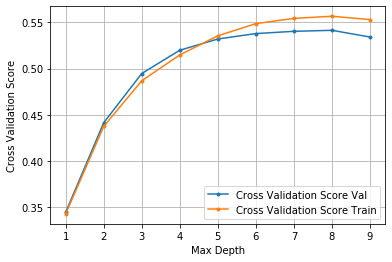

In [57]:
plt.figure()
plt.plot(depths, cross_validation_scores_val,label="Cross Validation Score Val",marker='.')
plt.plot(depths, cross_validation_scores_train,label="Cross Validation Score Train",marker='.')
plt.legend()
plt.xlabel('Max Depth')
plt.ylabel('Cross Validation Score')
plt.grid()
plt.show()

In [110]:
tree = DecisionTreeRegressor(max_depth=8)
tree.fit(X_train_added_features, y_train)
print(f'Validation score with optimal max depth of 8: {tree.score(X_validation_added_features, y_validation)}')
print(f'Test score with optimal max depth of 8: {tree.score(X_test_added_features, y_test)}')

Validation score with optimal max depth of 8: 0.566898810209528
Test score with optimal max depth of 8: 0.5802410560734743


In [107]:
get_errors(X_test_added_features, y_test, tree)

RMSE=35.31409002707132


In [60]:
from sklearn.ensemble import RandomForestRegressor
cross_validation_scores_val = []
cross_validation_scores_train = []

max_depth_lst=range(1,10)
for max_depth in max_depth_lst:
    my_random_forest = RandomForestRegressor(n_estimators=100, max_depth=max_depth)
    my_random_forest.fit(X_train_added_features, y_train.values.ravel())
    cv_score_val = np.mean(cross_val_score(tree, X_validation_added_features, y_validation, cv = 5))
    cross_validation_scores_val.append(cv_score_val)
    cv_score_train = np.mean(cross_val_score(tree, X_train_added_features, y_train, cv = 5))
    cross_validation_scores_train.append(cv_score_train)
    

    print(f'depth = {max_depth}')
    print(f"DT R^2 score on training set: {my_random_forest.score(X_train_added_features, y_train):0.3f}")
    print(f"DT R^2 score on validation set: {my_random_forest.score(X_validation_added_features, y_validation):0.3f}")
    


depth = 1
DT R^2 score on training set: 0.343
DT R^2 score on validation set: 0.344
depth = 2
DT R^2 score on training set: 0.441
DT R^2 score on validation set: 0.443
depth = 3
DT R^2 score on training set: 0.502
DT R^2 score on validation set: 0.506
depth = 4
DT R^2 score on training set: 0.538
DT R^2 score on validation set: 0.540
depth = 5
DT R^2 score on training set: 0.564
DT R^2 score on validation set: 0.561
depth = 6
DT R^2 score on training set: 0.589
DT R^2 score on validation set: 0.577
depth = 7
DT R^2 score on training set: 0.609
DT R^2 score on validation set: 0.587


KeyboardInterrupt: 

In [66]:
from sklearn.ensemble import RandomForestRegressor

from sklearn.model_selection import GridSearchCV

param_grid = {
    'bootstrap': [True],
    'max_depth': [1,2,3,4,5,6,7,8,9,10],
    'max_features': [1,2,3,4,5],
    'min_samples_leaf': [1,2,3,4,5],
    'min_samples_split': [1,2,3,4,5,6,7,8,9,10],
    'n_estimators': [10,20,30,100,200]
}

my_random_forest = RandomForestRegressor()

clf = GridSearchCV(my_random_forest, param_grid)

my_random_forest.fit(X_remainder_added_features, y_remainder.values.ravel())


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

In [69]:
my_random_forest.score(X_test_added_features, y_test)

0.6407327945560449

In [70]:
get_errors(X_test_added_features, y_test, my_random_forest)

RMSE=32.66067413071984


In [ ]:
X_train_added_features.shape

In [ ]:
X_test_added_features.shape

In [ ]:
X_validation_added_features.shape

In [ ]:
#Scaling data for KNN (only scaling continuous data and not the one hot encoded data)

In [ ]:
from sklearn.preprocessing import StandardScaler

scalerx = StandardScaler()
scalerx.fit(X_train_added_features[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']])
X_train_added_features[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']] = scalerx.transform(X_train_added_features[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']])
X_validation_added_features[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']] = scalerx.transform(X_validation_added_features[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']])
X_test_added_features[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']] = scalerx.transform(X_test_added_features[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']])
X_remainder_added_features[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']] = scalerx.transform(X_remainder_added_features[['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']])



In [72]:
from sklearn.neighbors import KNeighborsRegressor

param_grid = {'n_neighbors':[2,3,4,5,6,7,8,9]}

KNN = KNeighborsRegressor()

KNN_model = GridSearchCV(KNN, param_grid, cv=5)
KNN_model.fit(X_remainder_added_features,y_remainder)
KNN_model.best_params_


{'n_neighbors': 9}

In [73]:
KNN_model.score(X_test_added_features,y_test)

KeyboardInterrupt: 

In [ ]:
#Lets try KNN 
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler


KNNmodel = KNeighborsRegressor(weights='distance', n_neighbors=2)
KNNmodel.fit(X_train_added_features, scaled_y_remainder)

print(f"R^2 score on training set: {KNNmodel.score(X_train_added_features, scaled_y_remainder)}")
print(f"R^2 score on test set: {KNNmodel.score(X_test_added_features, scaled_y_test)}")

In [ ]:
get_errors(X_test_added_features, y_test, KNN_model)

### Neural Network 

In [74]:
y_train_scaled=np.log10(y_train+1)
y_test_scaled=np.log10(y_test+1)
y_validation_scaled=np.log10(y_validation+1)

In [75]:
y_train_scaled

,price
27010,2.082785
29257,1.908485
33781,2.100371
29641,1.959041
27480,2.082785
...,...
7813,1.785330
32511,2.064458
5192,2.178977
12172,2.292256


In [85]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
#from tensorflow.metrics import RootMeanSquaredError
model = Sequential([
    Dense(512, activation='relu', input_shape=(1227,)),
    Dense(512),
    Dense(1),
])


model.compile(
              loss='mse', optimizer='adam')

hist = model.fit(X_train_added_features, y_train_scaled,
          batch_size=32, epochs=5,
          validation_data=(X_validation_added_features, y_validation_scaled))



Train on 23894 samples, validate on 10241 samples
Epoch 1/5
23894/23894 [==============================] - 14s 592us/step - loss: 2.2098 - val_loss: 0.0257
Epoch 2/5
23894/23894 [==============================] - 13s 560us/step - loss: 0.0361 - val_loss: 0.0600
Epoch 3/5
23894/23894 [==============================] - 13s 553us/step - loss: 0.0630 - val_loss: 0.0894
Epoch 4/5
23894/23894 [==============================] - 14s 589us/step - loss: 0.0583 - val_loss: 0.0526
Epoch 5/5
23894/23894 [==============================] - 13s 556us/step - loss: 0.0589 - val_loss: 0.0255


In [ ]:
print(X_val.shape)
print(y_validation.shape)
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

In [93]:
y_pred_log=model.predict(X_test_added_features)
y_pred_normal=(10**y_pred_log)-1
y_test_df=y_test.copy()
y_test_df["pred"]=y_pred_normal
y_test_df["abs_error"]=np.abs(y_test_df["pred"]-y_test_df["price"])
RMSE=((((y_test_df["price"]-y_test_df["pred"])**(2))/len(y_test_df)).sum())**(1/2)

print(f'RMSE: {RMSE}')
fig=px.histogram(x=y_test_df['abs_error'], nbins=30)


fig.show()


RMSE: 40.199227169238405


In [ ]:
plt.figure()
plt.hist(y_test_df[y_test_df["abs_error"]<500], bins=10)
plt.show()

In [89]:
get_errors(X_test_added_features, y_test_scaled, model)

RMSE=0.16189562850090666


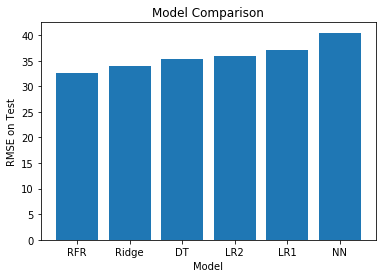

In [109]:
plt.figure()
plt.bar(x=["RFR", "Ridge", "DT", "LR2", "LR1",  "NN"], height=[32.6, 34, 35.32, 36, 37,40.47])
plt.xlabel("Model")
plt.ylabel("RMSE on Test")
plt.title("Model Comparison")
plt.show()

In [104]:
RMSE=[37, 36 , 34, 40.47, 32.6, 40.19]
RMSE=sorted(RMSE)
RMSE

[32.6, 34, 36, 37, 40.19, 40.47]